**Siguientes pasos:**

- Redactar memoria primera vuelta, algoritmo genético, shap, error obtenido, etc
- Análisis de error obtenido
- Interpretación del modelo


**Preguntar a Raúl**:
- Ejecuto Random Forest con los datos sin preprocesar para ver la mejora del prepro?
- Exporto el predictor? Podría ser interesante tener un programita que lo calcule. Cómo lo hago? Con un .py? Con una API? pickle y h5? Hay que usar pipelines?
- Cómo hago el análisis de resultados? Tengo que interpretar los resultados de todos los modelos?
    - Cómo hago el análisis de error obtenido? Tengo que hacer validación cruzada?
    - Cómo interpreto el modelo? Hasta ahora he pensado:
        - Combinación de features: ir añadiendo de una en una y ver el error(lo malo es que no hago validación cruzada)
            Hay features que al añadirlas aumenta el error, cómo trato esto?
        - Algortimo genético. Creo que es inviable, aunque muy interesante. Lo describo en la memoria y ya?
        - SHAP. Qué sería interesante ver?
- Las librerías y su documentación se citan en la memoria?
- Cuando debería entregar el TFG? Hay convocatoria ordinaria y extraordinaria?

Podría ser interesante enfocar la memoria como un flujo completo de un proyecto de Data Science: 
  - Objetivo
  - Obtención de los datos
  - Limpieza de datos
  - Análisis de datos
  - Refinar los datos
  - Creación de modelos
  - Validación de modelos(Conjunto de test)
  - Evaluar los modelos(Análisis de resultados)
  - (Interfaz de despliegue)
  - Conclusiones
  - Referencia(Barton Poulson Professor, Designer, Data Analytics Expert - Curso LinkedIn)

**Planificación Calendario**
* 27/03 - 18/04 (3 Semanas) -> Análisis y preprocesamiento
* 18/04 - 23/05 (5 Semanas) -> Modelos
* 23/05 - 13/06 (3 Semanas) -> Análisis de resultados
* 13/06 - 20/06 (1 Semana) -> Finiquitar memoria
* 20/06 ENTREGA DEL TFG
* 20/06 - 30/06 (1-2 semanas) -> Preparar presentación
* 30/06 PRESENTACIÓN TFG

# Importar Liberías

In [9]:
import pandas as pd
import numpy as np
import sklearn 
pd.set_option("display.max_columns", None)
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import models
from keras import backend as K
import requests
from matplotlib.pyplot import xticks
import shap
shap.initjs()

# Importar dataset

In [43]:
df = pd.read_csv('https://raw.githubusercontent.com/MiguelRocaGarcia/DatasetTFG/master/PreprocessedDataset.csv', sep=',')

In [3]:
df

,Year,Female,Male,Life Expectancy,% Death Cardiovascular,Low CI Value % Death Cardiovascular,High CI Value % Death Cardiovascular,Suicides Rate,Alcohol Abuse,Poisoning Mortality Rate,Tobacco Prevalence,% of Births Attended By Skilled Personal,Incidence of Malaria,Incidence of Tuberculosis,Low CI Value Incidence of Tuberculosis,High CI Value Incidence of Tuberculosis,Road Traffic Deaths,Adolescent Birth Rate,Universal Heath Care Coverage,Population 10 Percentage SDG Total,Population 10 Percentage SDG Urban,Population 10 Percentage SDG Rural,Population 25 Percentage SDG Total,Population 25 Percentage SDG Urban,Population 25 Percentage SDG Rural,Doctors,Nurses and Midwifes,Dentists,Pharmacists,Basic Drinking Water Services,Basic Sanization Services Total,Basic Sanization Services Urban,Basic Sanization Services Rural,Safely Sanitation Total,Safely Sanitation Urban,Safely Sanitation Rural,Basic Hand Washing Total,Basic Hand Washing Urban,Basic Hand Washing Rural,Clean Fuel and Technology,Birth Rate,% Injury Deaths,GDP per Capita,% Population $1.90 a day,% Population $3.20 a day,% Population $5.50 a day,Income per Capita,GNI per Capita,Homicide Rate,Government Expenditure Education,Government Expenditure Military,Government Expenditure Health,Diet Composition Alcoholic Beverages,Diet Composition Other,Diet Composition Sugar,Diet Composition Oils And Fats,Diet Composition Meat,Diet Composition Dairy And Eggs,Diet Composition Fruit And Vegetables,Diet Composition Starchy Roots,Diet Composition Pulses,Diet Composition Cereals And Grains,Vegetable Consumption,Fruit Consumption Plantains,Fruit Consumption Other,Fruit Consumption Bananas,Fruit Consumption Dates,Fruit Consumption Other Citrus,Fruit Consumption Oranges And Mandarines,Fruit Consumption Apples,Fruit Consumption Lemons And Limes,Fruit Consumption Grapes,Fruit Consumption Grapefruit,Fruit Consumption Pineapples,Cereal Consumption Oats,Cereal Consumption Rye,Cereal Consumption Barley,Cereal Consumption Sorghum,Cereal Consumption Maize,Cereal Consumption Wheat,Cereal Consumption Rice,Diet Calories Animal Protein,Diet Calories Plant Protein,Diet Calories Fat,Diet Calories Carbohydrates,Intervention Against NTDs per capita,Battle Related Deaths %,Conflict and Terrorism Deaths %
0,-1.676227,1,1,-1.811064,1.635334,1.175056,1.780172,-0.418101,-1.744587,0.654428,-0.106513,-1.799759,0.948818,0.838319,0.783940,0.872131,-0.076141,1.102993,-1.684581,0.487389,0.040946,0.569680,-0.009104,-0.304262,0.055954,-1.087623,-1.193874,-1.222978,-1.024286,-1.609031,-1.350799,-1.469300,-1.104711,-0.062266,1.023815,-0.248500,-1.229130,-0.733760,-1.177121,-1.188014,1.685753,0.681710,-1.233231,0.994439,0.876812,0.870163,-1.095904,-1.197077,1.021791,0.159759,0.230526,-1.332338,-1.911954,-0.991231,-1.87640,-1.034323,-0.569039,-0.330174,-1.003075,-1.096987,-0.656821,1.639689,-0.679713,-0.937830,0.129569,-1.813564,-0.718468,0.509331,-1.163691,-0.613941,-0.549370,1.407984,-1.019481,-1.318237,-0.922712,-0.728863,1.733196,1.671335,0.657377,1.470044,0.182323,-0.727586,0.815761,-0.856345,-0.319981,0.978972,1.961721,3.813995
1,-1.676227,1,0,-1.700317,1.635334,1.175056,1.780172,-0.418101,-1.744587,0.654428,-0.106513,-1.799759,0.948818,0.838319,0.783940,0.872131,-0.076141,1.102993,-1.684581,0.487389,0.040946,0.569680,-0.009104,-0.304262,0.055954,-1.087623,-1.193874,-1.222978,-1.024286,-1.609031,-1.350799,-1.469300,-1.104711,-0.062266,1.023815,-0.248500,-1.229130,-0.733760,-1.177121,-1.188014,1.685753,0.681710,-1.233231,0.994438,0.876811,0.870163,-1.095904,-1.197077,1.021791,0.159759,0.230526,-1.332338,-1.911954,-0.991231,-1.87640,-1.034323,-0.569039,-0.330174,-1.003075,-1.096987,-0.656821,1.639689,-0.679713,-0.937830,0.129569,-1.813564,-0.718468,0.509331,-1.163691,-0.613941,-0.549369,1.407984,-1.019481,-1.318237,-0.922712,-0.728863,1.733196,1.671335,0.657377,1.470044,0.182323,-0.727586,0.815761,-0.856345,-0.319981,0.978972,1.961721,3.813995
2,-1.676227,0,1,-1.915730,1.635334,1.175056,1.780172,-0.418101,-1.744587,0.6

# Separación de la variable objetivo

In [51]:
X = df.drop(columns=['Life Expectancy'])
y = df['Life Expectancy']

# División en conjunto de entrenamiento y de test

In [45]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=21)

# Funciones

In [6]:
#Función para deshacer la estandarización  en la variable objetivo
df_filled = pd.read_csv('https://raw.githubusercontent.com/MiguelRocaGarcia/DatasetTFG/master/FilledDataset.csv',sep=',')
scalerLE = StandardScaler()
scalerLE.fit(df_filled['Life Expectancy'].values.reshape(-1,1))

StandardScaler()

In [7]:
y_test_unstandarized = scalerLE.inverse_transform(y_test.values.reshape(-1,1)).flatten()

In [8]:
#Error de entrenamiento y de test según diferentes métricas de medida:
def errorMetrics(y_train_predicted,y_test_predicted):
    y_test_predicted_unstandarized = scalerLE.inverse_transform(y_test_predicted)

    print("\nRMSE Train standarized values: ", str(mean_squared_error(y_train, y_train_predicted, squared = False)))
    print("RMSE Test standarized values: ", str(mean_squared_error(y_test, y_test_predicted, squared = False)))
    print("RMSE Test absolute values: ", str(mean_squared_error(y_test_unstandarized, y_test_predicted_unstandarized, squared = False)))

    print("\nMAE Train standarized values: ", str(mean_absolute_error(y_train, y_train_predicted)))
    print("MAE Test standarized values: ", str(mean_absolute_error(y_test, y_test_predicted)))
    print("MAE Test absolute values: ", str(mean_absolute_error(y_test_unstandarized, y_test_predicted_unstandarized)))

    print("\nR2 Train: ", str(r2_score(y_train, y_train_predicted)))
    print("R2 Test: ", str(r2_score(y_test, y_test_predicted)))

# Modelos

## Regresión Lineal

In [ ]:
#Entrenamiento
linear = LinearRegression()
linear.fit(X_train, y_train) 

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
print("Regresión Lineal:")
errorMetrics(linear.predict(X_train), linear.predict(X_test))

Regresión Lineal:

RMSE Train standarized values:  0.27293409601150037
RMSE Test standarized values:  0.2808986365179005
RMSE Test absolute values:  2.8179504274091136

MAE Train standarized values:  0.1990167505435979
MAE Test standarized values:  0.20302305433329956
MAE Test absolute values:  2.0367094330697015

R2 Train:  0.9247785165850644
R2 Test:  0.9240373819236389


In [ ]:
#Mostrar distribución de la variable objetivo real y calculada
# plt.figure(figsize=(12,6))
# sns.distplot(linearPredictions['Prediction Standarized'], color='b')
# sns.distplot(linearPredictions['Real Value Standarized'], color='r')

## Elastic-Net

In [ ]:
#GridSearch de la regresión Elastic-Net

grid_EN = GridSearchCV(
    ElasticNet(),
    {'alpha': (0,0.00001,0.0001,0.001,0.1,1,10,100,1000),
    'l1_ratio': (0,0.001, 0.01, 0.1, 0.5,0.9,0.99,0.999,1)},
    scoring='neg_root_mean_squared_error',                                 
    cv=5,
    n_jobs=-1,
    verbose = 0,
    return_train_score = True
)

grid_EN.fit(X_train, y_train)

In [ ]:
resultados = pd.DataFrame(grid_EN.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False) 

In [ ]:
errorMetrics(grid_EN.predict(X_train), grid_EN.predict(X_test))

## KNN

In [ ]:
#GridSearch de la regresión KNN 
grid_KNN = GridSearchCV(
    KNeighborsRegressor(),
    {'n_neighbors': (2,3,4,5,10),
     'weights': ('uniform', 'distance')},
     scoring='neg_root_mean_squared_error',                              
     cv=5,
     n_jobs=-1,
     return_train_score = True
)
grid_KNN.fit(X_train, y_train)

In [ ]:
resultados = pd.DataFrame(grid_KNN.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False)

In [ ]:
errorMetrics(grid_KNN.predict(X_train), grid_KNN.predict(X_test))

## Random Forrest Regressor

In [ ]:
rf = RandomForestRegressor(n_estimators=100, criterion='mse', max_depth=100, n_jobs=-1)
rf.fit(X_train,y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=100, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

In [ ]:
errorMetrics(rf.predict(X_train), rf.predict(X_test))


RMSE Train standarized values:  0.028154138576077552
RMSE Test standarized values:  0.07062329342960864
RMSE Test absolute values:  0.7084866711067952

MAE Train standarized values:  0.017202013530308157
MAE Test standarized values:  0.04537513387295614
MAE Test absolute values:  0.4551993540306637

R2 Train:  0.9991995931516742
R2 Test:  0.9951982826157288


Se ha probado con más árboles y no mejora

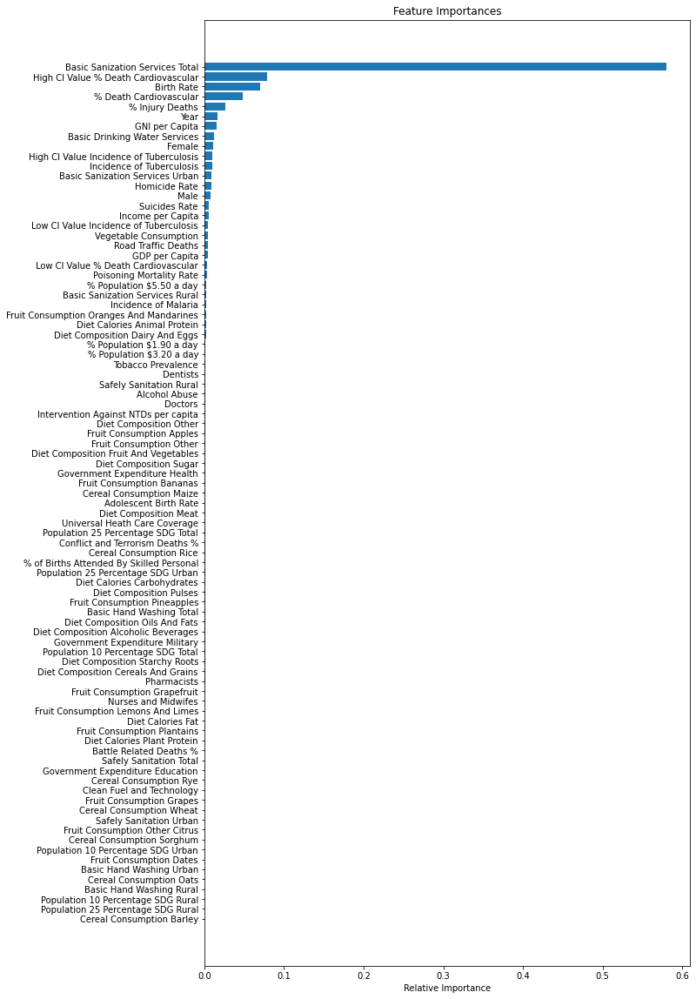

In [ ]:
# plotting feature importances
features = X.columns
importances = rf.feature_importances_
indices = np.argsort(importances)
plt.figure(figsize=(10,20))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

In [ ]:
orderedFeaturesRF = orderedFeatures[::-1]

## Red de Neuronas

In [10]:
#Cortesía de https://jmlb.github.io/ml/2017/03/20/CoeffDetermination_CustomMetric4Keras/
def r2_score_metric(y_true, y_pred):
    SS_res =  K.sum(K.square( y_true-y_pred ))
    SS_tot = K.sum(K.square( y_true - K.mean(y_true) ) )
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )

In [11]:
#Importamos los pesos de la red desde GitHub
load_NN_Model = False
if (load_NN_Model):
    r = requests.get('https://github.com/MiguelRocaGarcia/DatasetTFG/raw/master/NN_Model.h5', allow_redirects=True)
    open('NN_Model.h5', 'wb').write(r.content)  
    NN_model = tf.keras.models.load_model('NN_Model.h5', compile=False)
    NN_model.compile(loss='mse', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['mae', 'mse', r2_score_metric])

In [ ]:
NN_model = keras.Sequential([layers.Dense(350, activation=tf.nn.relu, input_shape=(len(X_train.keys()),)),
                          layers.Dense(350, activation=tf.nn.relu),
                          layers.Dense(1)])
                         
# optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.001)
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)

NN_model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', r2_score_metric])

In [ ]:
NN_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 350)               30800     
_________________________________________________________________
dense_1 (Dense)              (None, 350)               122850    
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 351       
Total params: 154,001
Trainable params: 154,001
Non-trainable params: 0
_________________________________________________________________


In [ ]:
class PrintEpochMetrics(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs):
        if (epoch%20 == 0):
            print(logs)

In [ ]:
#Early stop: Para cuando el valor de validación empieza a empeorar respectp al de entrenamiento
early_stop = keras.callbacks.EarlyStopping(monitor='val_loss', patience=30)

hist = NN_model.fit(X_train, y_train, epochs=1000, verbose=0, validation_split=0.3, callbacks=[early_stop, PrintEpochMetrics()])

{'loss': 0.13501733541488647, 'mae': 0.2518026530742645, 'mse': 0.13501733541488647, 'r2_score_metric': 0.8595440983772278, 'val_loss': 0.05408341810107231, 'val_mae': 0.1688615083694458, 'val_mse': 0.05408341810107231, 'val_r2_score_metric': 0.9412819743156433}
{'loss': 0.0026390133425593376, 'mae': 0.0377783440053463, 'mse': 0.0026390133425593376, 'r2_score_metric': 0.997202455997467, 'val_loss': 0.0052178045734763145, 'val_mae': 0.050376635044813156, 'val_mse': 0.0052178045734763145, 'val_r2_score_metric': 0.9941689968109131}
{'loss': 0.0009555236320011318, 'mae': 0.023001713678240776, 'mse': 0.0009555236320011318, 'r2_score_metric': 0.9989743232727051, 'val_loss': 0.003706514835357666, 'val_mae': 0.04129207134246826, 'val_mse': 0.003706514835357666, 'val_r2_score_metric': 0.9959049820899963}
{'loss': 0.0007666382589377463, 'mae': 0.020987924188375473, 'mse': 0.0007666382589377463, 'r2_score_metric': 0.9991560578346252, 'val_loss': 0.003095831722021103, 'val_mae': 0.0383965335786342

In [ ]:
#Guardamos el modelo
NN_model.save('NN_Model.h5')

In [ ]:
pd.DataFrame(hist.history)

,loss,mae,mse,r2_score_metric,val_loss,val_mae,val_mse,val_r2_score_metric
0,0.135017,0.251803,0.135017,0.859544,0.054083,0.168862,0.054083,0.941282
1,0.041083,0.144036,0.041083,0.955654,0.031154,0.126510,0.031154,0.965851
2,0.025279,0.112564,0.025279,0.973002,0.022892,0.106973,0.022892,0.974691
3,0.017990,0.095494,0.017990,0.980415,0.018893,0.097480,0.018893,0.979104
4,0.013963,0.084505,0.013963,0.984778,0.015467,0.088168,0.015467,0.982906
...,...,...,...,...,...,...,...,...
393,0.000213,0.010649,0.000213,0.999768,0.001582,0.025431,0.001582,0.998207
394,0.000209,0.010207,0.000209,0.999776,0.001738,0.026674,0.001738,0.998059
395,0.000266,0.011885,0.000266,0.999717,0.001794,0.028185,0.001794,0.997998
396,0.000190,0.010040,0.000190,0.999792,0.001605,0.026258,0.001605,0.998183


In [ ]:
def plotHistory(history):
    history = pd.DataFrame(hist.history)
    history['epoch'] = hist.epoch 

    plt.figure(figsize=(12,6))
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error(RMSE)')
    plt.plot(history['epoch'], (history['mse'] ** 1/2), label='Train Error')
    plt.plot(history['epoch'], (history['val_mse'] ** 1/2), label='Validation Error')
    plt.legend()

    plt.figure(figsize=(12,6))
    plt.xlabel('Epoch')
    plt.ylabel('Mean Absolute Error(MAE)')
    plt.plot(history['epoch'], history['mae'], label='Train Error')
    plt.plot(history['epoch'], history['val_mae'], label='Validation Error')
    plt.legend()

    plt.figure(figsize=(12,6))
    plt.xlabel('Epoch')
    plt.ylabel('Coefficient of Determination R2')
    plt.plot(history['epoch'], history['r2_score_metric'], label='Train Error')
    plt.plot(history['epoch'], history['val_r2_score_metric'], label='Validation Error')
    plt.legend()

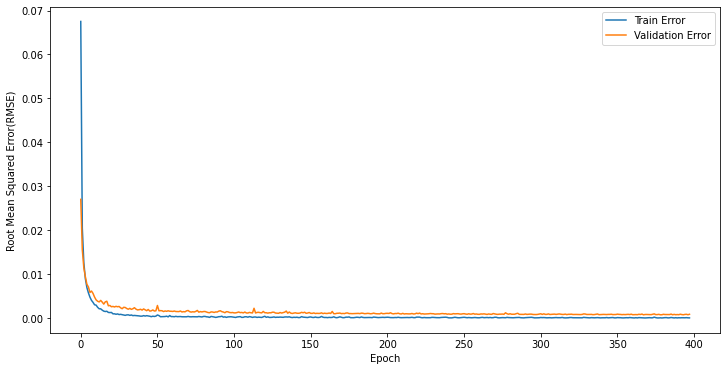

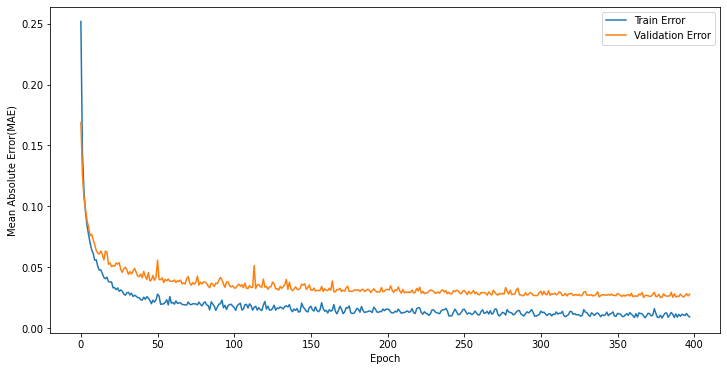

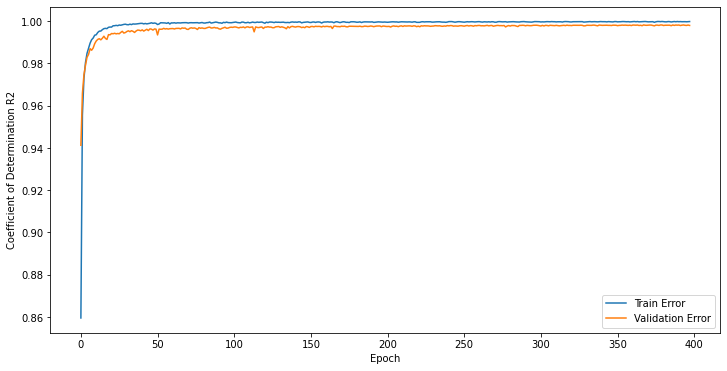

In [ ]:
plotHistory(hist)

In [ ]:
print('Red de Neuronas:')
errorMetrics(NN_model.predict(X_train).flatten(),NN_model.predict(X_test).flatten())

Red de Neuronas:

RMSE Train standarized values:  0.027674162682268386
RMSE Test standarized values:  0.04694564369527847
RMSE Test absolute values:  0.4709545372392034

MAE Train standarized values:  0.0177312895160565
MAE Test standarized values:  0.029433016272691227
MAE Test absolute values:  0.2952694045818755

R2 Train:  0.9992266514292347
R2 Test:  0.9978782644228321


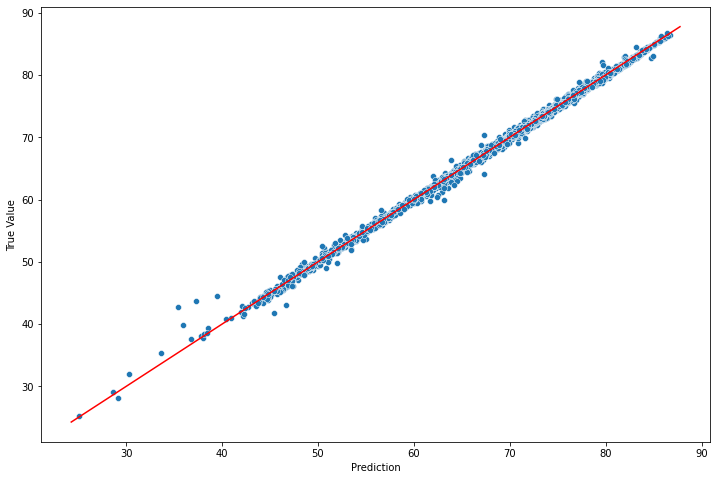

In [ ]:
plt.figure(figsize=(12,8))
sns.scatterplot(y=y_test_unstandarized.flatten(), x=scalerLE.inverse_transform(NN_model.predict(X_test).flatten()))
plt.xlabel('Prediction')
plt.ylabel('True Value')

plt.plot([y_test_unstandarized.min()-1, y_test_unstandarized.max()+1], [y_test_unstandarized.min()-1, y_test_unstandarized.max()+1], color='r')

# Predicción

In [ ]:
#Aplicamos las transformaciones de estandarización y Yeo-Johnson a todo el conjunto de datos para obtener el scaler_total y power_YJ
df_transformed = df_filled.copy()
df_transformed.drop(columns=['Country'], inplace=True)
df_transformed.insert(loc=1,column='Female',value=df_transformed['Gender'].apply(lambda gender: 0 if gender == 'Male' else 1))
df_transformed.insert(loc=2,column='Male',value=df_transformed['Gender'].apply(lambda gender: 0 if gender == 'Female' else 1))
df_transformed.drop(columns=['Gender'], inplace=True)
featuresScale = ['Life Expectancy', '% Death Cardiovascular','Tobacco Prevalence','Road Traffic Deaths','% Injury Deaths', 
            'Government Expenditure Education', 'Government Expenditure Health', 'Diet Composition Cereals And Grains', 
            'Diet Composition Fruit And Vegetables', 'Diet Composition Oils And Fats', 'Diet Calories Plant Protein', 
            'Diet Calories Carbohydrates']
scaler_total = StandardScaler()
df_transformed[featuresScale] = scaler_total.fit_transform(df_transformed[featuresScale])
columnsYJ = list(df_transformed.columns)
columnsYJ.remove('Male')
columnsYJ.remove('Female')
columnsYJ.remove('Life Expectancy')
power_YJ = PowerTransformer(method='yeo-johnson', standardize=True)
power_YJ.fit(df_transformed[columnsYJ])

PowerTransformer(copy=True, method='yeo-johnson', standardize=True)

In [ ]:
def predictLifeExpectancy(d):
    #Aplicamos las transformaciones
    data = d.copy()
    data.drop(columns=['Country'], inplace=True)
    data.insert(loc=1,column='Female',value=data['Gender'].apply(lambda gender: 0 if gender == 'Male' else 1))
    data.insert(loc=2,column='Male',value=data['Gender'].apply(lambda gender: 0 if gender == 'Female' else 1))
    data.drop(columns=['Gender'], inplace=True)

    data[featuresScale] = scaler_total.transform(data[featuresScale])
    data[columnsYJ] = power_YJ.transform(data[columnsYJ])

    data.drop(columns=['Life Expectancy'], inplace=True)

    #Calculamos la esperanza de vida mediante la Red de Neuronas
    life_expectancy = NN_model.predict(data)
    return scalerLE.inverse_transform(life_expectancy).flatten()

In [ ]:
def compareLifeExpectancy(dataOriginal, data):
    print(f"País: {dataOriginal['Country'].iloc[0]}. Año: {int (dataOriginal['Year'].iloc[0])}. Género: {dataOriginal['Gender'].iloc[0]}")
    print(f"Esperanza de vida real: {dataOriginal['Life Expectancy'].iloc[0]}")
    print(f"Esperanza de vida según el predictor: {predictLifeExpectancy(dataOriginal)[0]}")
    print(f"Esperanza de vida tras los cambios: {predictLifeExpectancy(data)[0]}")

In [ ]:
# Obtener los datos de un país en un año y un género:
country = 'Spain' #Nombre del país en inglés
year = 2010 # Rango dentro del intervalo [1990, 2019]
gender = 'Both sexes' #Posibles valores: Male, Female y Both sexes

data = df_filled[(df_filled['Country'] == country)&(df_filled['Year'] == year)&(df_filled['Gender'] == gender)]
dataOriginal = data.copy() # Guardamos 
data

,Country,Year,Gender,Life Expectancy,% Death Cardiovascular,Low CI Value % Death Cardiovascular,High CI Value % Death Cardiovascular,Suicides Rate,Alcohol Abuse,Poisoning Mortality Rate,Tobacco Prevalence,% of Births Attended By Skilled Personal,Incidence of Malaria,Incidence of Tuberculosis,Low CI Value Incidence of Tuberculosis,High CI Value Incidence of Tuberculosis,Road Traffic Deaths,Adolescent Birth Rate,Universal Heath Care Coverage,Population 10 Percentage SDG Total,Population 10 Percentage SDG Urban,Population 10 Percentage SDG Rural,Population 25 Percentage SDG Total,Population 25 Percentage SDG Urban,Population 25 Percentage SDG Rural,Doctors,Nurses and Midwifes,Dentists,Pharmacists,Basic Drinking Water Services,Basic Sanization Services Total,Basic Sanization Services Urban,Basic Sanization Services Rural,Safely Sanitation Total,Safely Sanitation Urban,Safely Sanitation Rural,Basic Hand Washing Total,Basic Hand Washing Urban,Basic Hand Washing Rural,Clean Fuel and Technology,Birth Rate,% Injury Deaths,GDP per Capita,% Population $1.90 a day,% Population $3.20 a day,% Population $5.50 a day,Income per Capita,GNI per Capita,Homicide Rate,Government Expenditure Education,Government Expenditure Military,Government Expenditure Health,Diet Composition Alcoholic Beverages,Diet Composition Other,Diet Composition Sugar,Diet Composition Oils And Fats,Diet Composition Meat,Diet Composition Dairy And Eggs,Diet Composition Fruit And Vegetables,Diet Composition Starchy Roots,Diet Composition Pulses,Diet Composition Cereals And Grains,Vegetable Consumption,Fruit Consumption Plantains,Fruit Consumption Other,Fruit Consumption Bananas,Fruit Consumption Dates,Fruit Consumption Other Citrus,Fruit Consumption Oranges And Mandarines,Fruit Consumption Apples,Fruit Consumption Lemons And Limes,Fruit Consumption Grapes,Fruit Consumption Grapefruit,Fruit Consumption Pineapples,Cereal Consumption Oats,Cereal Consumption Rye,Cereal Consumption Barley,Cereal Consumption Sorghum,Cereal Consumption Maize,Cereal Consumption Wheat,Cereal Consumption Rice,Diet Calories Animal Protein,Diet Calories Plant Protein,Diet Calories Fat,Diet Calories Carbohydrates,Intervention Against NTDs per capita,Battle Related Deaths %,Conflict and Terrorism Deaths %
12120,Spain,2010.0,Both sexes,81.9,11.0,9.5,12.7,7.0,10.03,0.2,31.6,99.939903,0.002196,17.0,14.0,20.0,3.9,10.6,82.0,5.73,5.46,6.02,1.21,1.08,1.35,30.29,51.11,5.93,9.16,100.0,99.9,99.88,100.0,95.66,95.76,95.32,87.2,87.83,87.06,95.0,10.4,3.609927,30502.719708,0.7,1.1,2.3,25459.599345,31880.0,0.887412,10.56192,3.017532,7.173242,161.0,44.0,295.0,793.0,467.0,300.0,193.0,113.0,47.0,770.0,140.51,0.52,18.89,7.43,0.21,0.32,28.64,11.39,4.87,2.5,0.01,4.89,2.0,5.0,0.0,0.0,13.0,668.0,82.0,269.64,158.2,1296.09,1459.07,0.000005,0.000001,0.0


In [ ]:
#Modificar indicadores
data['% Death Cardiovascular'] -= 1
data['Alcohol Abuse'] -= 1.0
data['Tobacco Prevalence'] -= data['Tobacco Prevalence']*0.10     # Decrementamos en un 10%

In [ ]:
compareLifeExpectancy(dataOriginal, data)

País: Spain. Año: 2010. Género: Both sexes
Esperanza de vida real: 81.9
Esperanza de vida según el predictor: 81.88863372802734
Esperanza de vida tras los cambios: 81.95087432861328


In [ ]:
data_norm = data.copy()
data_norm.drop(columns=['Country'], inplace=True)
data_norm.insert(loc=1,column='Female',value=data_norm['Gender'].apply(lambda gender: 0 if gender == 'Male' else 1))
data_norm.insert(loc=2,column='Male',value=data_norm['Gender'].apply(lambda gender: 0 if gender == 'Female' else 1))
data_norm.drop(columns=['Gender'], inplace=True)
data_norm[featuresScale] = scaler_total.transform(data_norm[featuresScale])
data_norm[columnsYJ] = power_YJ.transform(data_norm[columnsYJ])
LE_VALUE = data_norm['Life Expectancy'].values[0]
data_norm.drop(columns=['Life Expectancy'], inplace=True)
data_norm = data_norm.values

LE_VALUE

1.3357938139153838

In [ ]:
def fitness (chromosome):
    diff_input = np.sum(abs(data_norm - np.array(chromosome).reshape(1,-1)))
    similarity_input = 1/(diff_input + 1)
    
    le_predicted = NN_model.predict(np.array(chromosome).reshape(1,-1))[0][0]
    diff_prediction = abs(LE_VALUE - le_predicted)
    similarity_prediction = 1/(diff_prediction + 1)
    
    score = W_INPUT * similarity_input + W_PREDICTION * similarity_prediction

    return score

In [ ]:
NN_model.predict(np.random.rand(87).reshape(1,-1))[0][0]

0.3291665

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

cosine_similarity(data_norm, data_norm_Original)[0][0]

0.9977436660859497

# Análisis de Resultados

## Análisis de error

- Ver error
- Ver dónde falla el modelo(qué características tienen que lo diferencian)


## Análisis de features

Wrapper Methods: 
Entrenar varias redes con subconjuntos de entradas para ver cuales son las variables que más influyen.
- Ir añadiendo una a una según la correlación y ver cuánto mejora
- Ir quitando una a una a ver cuánto empeora
- Todas las combianaciones posibles(creo que inviable pero quien sabe)
- Ir probando a mano

### Combinación de features

#### Por correlación con la variable objetivo

In [ ]:
# Obtenemos las features según el orden de correlación
corrFeatures = list(abs(df.corr().loc['Life Expectancy']).sort_values(ascending=False).index[1:])

In [ ]:
X_trainCorr = X_train[corrFeatures].reset_index(drop=True)
X_testCorr = X_test[corrFeatures].reset_index(drop=True)

In [ ]:
histList = []
models = []
for i in range(2,len(corrFeatures)):  
    print(f'Red de neuronas de las {i} features más correladas con la variable objetivo:')
    models.append(keras.Sequential([layers.Dense(350, activation=tf.nn.relu, input_shape=(i,)),
                            layers.Dense(350, activation=tf.nn.relu),
                            layers.Dense(1)]))
    models[-1].compile(loss='mse', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['mae', 'mse', r2_score_metric])
    histList.append(models[-1].fit(X_trainCorr[corrFeatures[:i]], y_train, epochs=100, verbose=0, validation_split=0.3))
    print(errorMetrics(models[-1].predict(X_trainCorr[corrFeatures[:i]]).flatten(),models[-1].predict(X_testCorr[corrFeatures[:i]]).flatten()))

Red de neuronas de las 2 features más correladas con la variable objetivo:

RMSE Train standarized values:  0.5227841826017554
RMSE Test standarized values:  0.5263545906736015
RMSE Test absolute values:  5.280343071955355

MAE Train standarized values:  0.40499874447653966
MAE Test standarized values:  0.40693337360655557
MAE Test absolute values:  4.082319980183325

R2 Train:  0.7240240823146995
R2 Test:  0.7332788271329134
None
Red de neuronas de las 3 features más correladas con la variable objetivo:

RMSE Train standarized values:  0.46984342469580254
RMSE Test standarized values:  0.4711140452041975
RMSE Test absolute values:  4.726174790906385

MAE Train standarized values:  0.3676700216656623
MAE Test standarized values:  0.3684365322982071
MAE Test absolute values:  3.6961229855849993

R2 Train:  0.7770884278451505
R2 Test:  0.7863254657330637
None
Red de neuronas de las 4 features más correladas con la variable objetivo:

RMSE Train standarized values:  0.38407385348008677
RM

Grafica que muestra cómo va bajando cada tipo de error con cada feature.

In [ ]:
errores = [errorsUnstandarized(models[i-2].predict(X_trainCorr[corrFeatures[:i]]).flatten()) for i in range(2,len(corrFeatures))]

i = 0
for name in ['Root Mean Squared Error(RMSE)', 'Mean Absolute Error(MAE)', 'Coefficient of Determination R2']:
    plt.figure(figsize=(12,6))
    plt.xlabel('Nº features')
    plt.ylabel(name)
    plt.plot(x=range(2, len(corrFeatures)), y=errores[:][i])
    i+=1

#### Según los resultados de Random Forrest

In [ ]:
# Orden de importancia de features según los resultados de Random Forest
orderedFeatureImportanceRF = [X.columns[i] for i in np.argsort(rf.feature_importances_)][::-1]

In [ ]:
X_trainRF = X_train[orderedFeatureImportanceRF].reset_index(drop=True)
X_testRF = X_test[orderedFeatureImportanceRF].reset_index(drop=True)

In [ ]:
def errorsUnstandarized(y_test_predicted):
    y_test_predicted_unstandarized = scalerLE.inverse_transform(y_test_predicted)
    rmse = mean_squared_error(y_test_unstandarized, y_test_predicted_unstandarized, squared = False)
    mae = mean_absolute_error(y_test_unstandarized, y_test_predicted_unstandarized)
    r2 = r2_score(y_test, y_test_predicted)
    return {'RMSE': rmse, 'MAE': mae, 'R2': r2}

In [ ]:
errors = []
for i in range(2,len(orderedFeatureImportanceRF)):  
    print(f'Red de neuronas de las {i} features más significativas según los resultados de Random Forest:')
    model = keras.Sequential([layers.Dense(350, activation=tf.nn.relu, input_shape=(i,)),
                            layers.Dense(350, activation=tf.nn.relu),
                            layers.Dense(1)])
    model.compile(loss='mse', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['mae', 'mse', r2_score_metric])
    hist = model.fit(X_trainRF[orderedFeatureImportanceRF[:i]], y_train, epochs=100, verbose=0, validation_split=0.3)

    errors.append(errorsUnstandarized(model.predict(X_testRF[orderedFeatureImportanceRF[:i]]).flatten()))
    print('Error en años:', errors[-1])

Red de neuronas de las 2 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 4.694994787915182, 'MAE': 3.3949679592188318, 'R2': 0.7891355055140244}
Red de neuronas de las 3 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 3.735569135819995, 'MAE': 2.656422586089302, 'R2': 0.8665106007862508}
Red de neuronas de las 4 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 3.251701324414465, 'MAE': 2.3141160702954258, 'R2': 0.898852649740495}
Red de neuronas de las 5 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 2.858652352755144, 'MAE': 2.1130364681660674, 'R2': 0.9218271585772997}
Red de neuronas de las 6 features más significativas según los resultados de Random Forest:
Error en años: {'RMSE': 2.504811177110985, 'MAE': 1.7583082274541144, 'R2': 0.9399817667729988}
Red de neuronas de las 7 features más significativas según los

In [ ]:
df_errors = pd.DataFrame(columns = ['RMSE' , 'MAE', 'R2', 'Feature Añadida'])
for i in range(len(errors)):
    df_errors = df_errors.append({'RMSE' : errors[i]['RMSE'] , 'MAE' : errors[i]['MAE'], 'R2' : errors[i]['R2'], 'Feature Añadida': orderedFeatureImportanceRF[i+1]} , ignore_index=True)

df_errors.head()

,RMSE,MAE,R2,Feature Añadida
0,4.694995,3.394968,0.789136,High CI Value % Death Cardiovascular
1,3.735569,2.656423,0.866511,Birth Rate
2,3.251701,2.314116,0.898853,% Death Cardiovascular
3,2.858652,2.113036,0.921827,% Injury Deaths
4,2.504811,1.758308,0.939982,Year


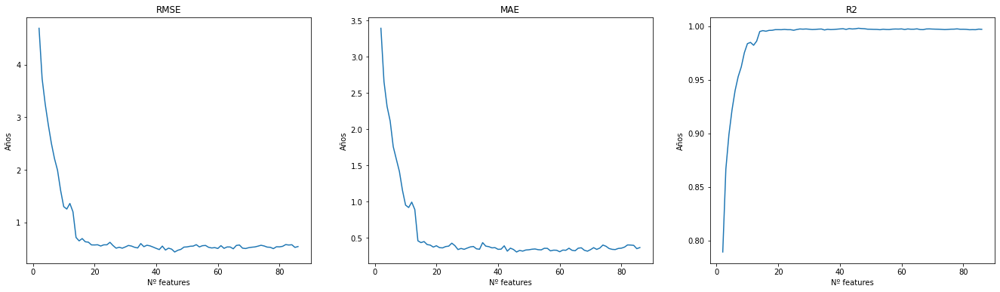

In [ ]:
plt.figure(figsize=(23,6))
plt.subplot(1,3,1)
plt.xlabel('Nº features')
plt.ylabel('Años')
plt.title('RMSE')
plt.plot(range(2, len(orderedFeatureImportanceRF)), df_errors['RMSE'])

plt.subplot(1,3,2)
plt.xlabel('Nº features')
plt.title('MAE')
plt.ylabel('Años')
plt.plot(range(2, len(orderedFeatureImportanceRF)), df_errors['MAE'])

plt.subplot(1,3,3)
plt.xlabel('Nº features')
plt.title('R2')
plt.ylabel('Años')
plt.plot(range(2, len(orderedFeatureImportanceRF)), df_errors['R2'])

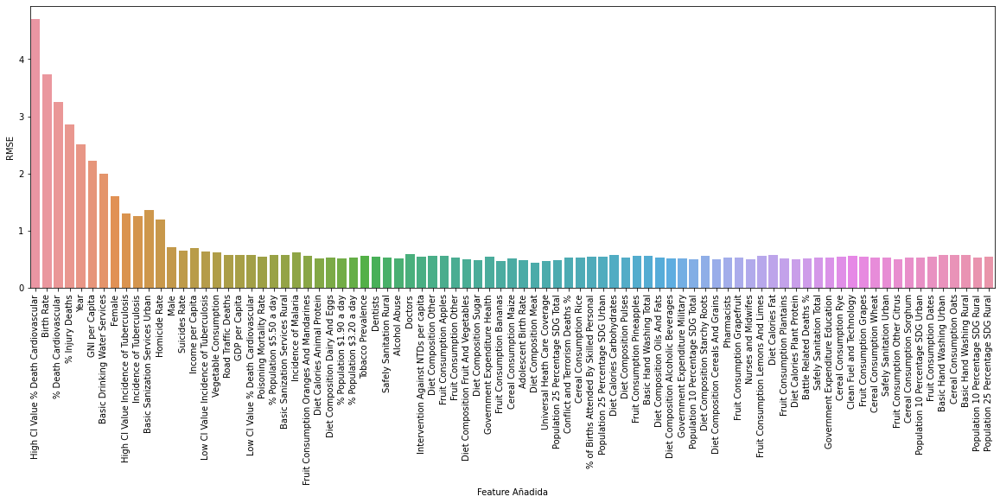

In [ ]:
plt.figure(figsize=(20,6))
sns.barplot(x='Feature Añadida', y='RMSE', data=df_errors)
_ = xticks(rotation=90)

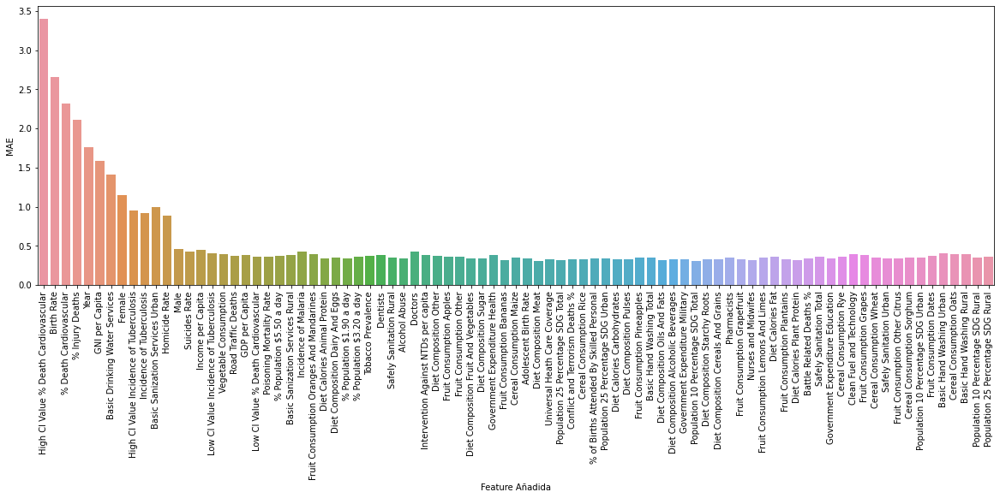

In [ ]:
plt.figure(figsize=(20,6))
sns.barplot(x='Feature Añadida', y='MAE', data=df_errors)
_ = xticks(rotation=90)

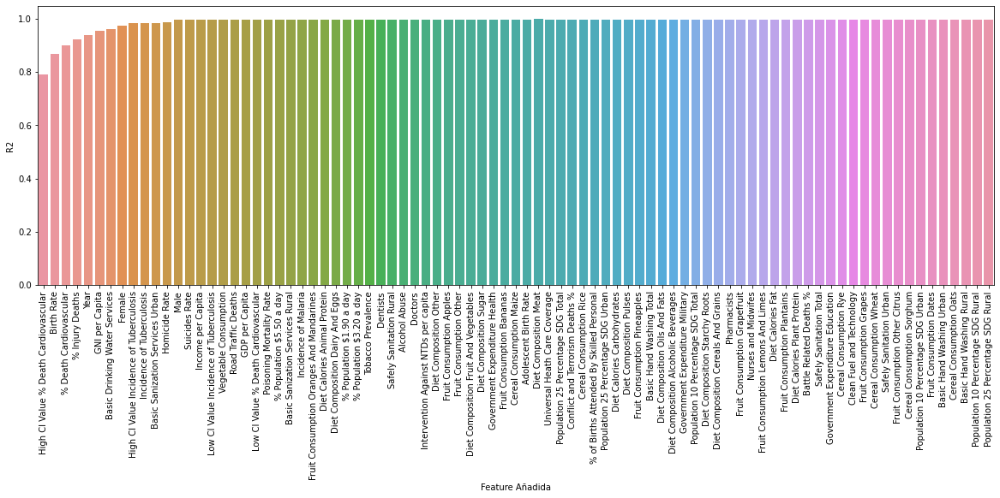

In [ ]:
plt.figure(figsize=(20,6))
sns.barplot(x='Feature Añadida', y='R2', data=df_errors)
_ = xticks(rotation=90)

In [ ]:
df_errors.head(15)

,RMSE,MAE,R2,Feature Añadida
0,4.694995,3.394968,0.789136,High CI Value % Death Cardiovascular
1,3.735569,2.656423,0.866511,Birth Rate
2,3.251701,2.314116,0.898853,% Death Cardiovascular
3,2.858652,2.113036,0.921827,% Injury Deaths
4,2.504811,1.758308,0.939982,Year
5,2.216393,1.585366,0.953008,GNI per Capita
6,1.991272,1.414972,0.962069,Basic Drinking Water Services
7,1.607418,1.153427,0.975283,Female
8,1.300165,0.950265,0.983829,High CI Value Incidence of Tuberculosis
9,1.253312,0.916903,0.984974,Incidence of Tuberculosis


In [ ]:
# Guardamos las features que mejoran el RMSE
featuresImproves = orderedFeatureImportanceRF[:2]
for i in range(1, df_errors.shape[0]):
    if (df_errors['RMSE'].iloc[i] < df_errors['RMSE'].iloc[i-1]):
        featuresImproves.append(df_errors['Feature Añadida'].iloc[i])

In [ ]:
model_SI = keras.Sequential([layers.Dense(350, activation=tf.nn.relu, input_shape=(len(featuresImproves),)),
                            layers.Dense(350, activation=tf.nn.relu),
                            layers.Dense(1)])
model_SI.compile(loss='mse', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['mae', 'mse', r2_score_metric])
hist = model_SI.fit(X_train[featuresImproves], y_train, epochs=100, verbose=0, validation_split=0.3)

In [ ]:
errorMetrics(model_SI.predict(X_train[featuresImproves]).flatten(),model_SI.predict(X_test[featuresImproves]).flatten())


RMSE Train standarized values:  0.03489893312301367
RMSE Test standarized values:  0.04979287633876299
RMSE Test absolute values:  0.49951781239059645

MAE Train standarized values:  0.022630915226429734
MAE Test standarized values:  0.033908306100725455
MAE Test absolute values:  0.34016518187605843

R2 Train:  0.9987701543505176
R2 Test:  0.9976130952368978


### Algoritmo Genético

In [ ]:
!pip install geneticalgorithm

     |████████████████████████████████| 51kB 4.2MB/s 
  Created wheel for func-timeout: filename=func_timeout-4.3.5-cp37-none-any.whl size=15079 sha256=9a1c844118738126856698ffca4851f17b4d0f84588f083e354803e23de192ef
  Stored in directory: /root/.cache/pip/wheels/46/7c/4f/24f1d2d5bbff92219debe7ea19af84f76ddeb90dd4ec544f26
Successfully built func-timeout


In [ ]:
import pandas as pd
import numpy as np
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PowerTransformer
from sklearn.metrics.pairwise import cosine_similarity
import tensorflow as tf
from keras import backend as K
import requests

df = pd.read_csv('https://raw.githubusercontent.com/MiguelRocaGarcia/DatasetTFG/master/PreprocessedDataset.csv', sep=',')

df_filled = pd.read_csv('https://raw.githubusercontent.com/MiguelRocaGarcia/DatasetTFG/master/FilledDataset.csv',sep=',')
scalerLE = StandardScaler()
scalerLE.fit(df_filled['Life Expectancy'].values.reshape(-1,1))

#Aplicamos las transformaciones de estandarización y Yeo-Johnson a todo el conjunto de datos para obtener el scaler_total y power_YJ
df_transformed = df_filled.copy()
df_transformed.drop(columns=['Country'], inplace=True)
df_transformed.insert(loc=1,column='Female',value=df_transformed['Gender'].apply(lambda gender: 0 if gender == 'Male' else 1))
df_transformed.insert(loc=2,column='Male',value=df_transformed['Gender'].apply(lambda gender: 0 if gender == 'Female' else 1))
df_transformed.drop(columns=['Gender'], inplace=True)
featuresScale = ['Life Expectancy', '% Death Cardiovascular','Tobacco Prevalence','Road Traffic Deaths','% Injury Deaths',
            'Government Expenditure Education', 'Government Expenditure Health', 'Diet Composition Cereals And Grains',
            'Diet Composition Fruit And Vegetables', 'Diet Composition Oils And Fats', 'Diet Calories Plant Protein',
            'Diet Calories Carbohydrates']
scaler_total = StandardScaler()
df_transformed[featuresScale] = scaler_total.fit_transform(df_transformed[featuresScale])
columnsYJ = list(df_transformed.columns)
columnsYJ.remove('Male')
columnsYJ.remove('Female')
columnsYJ.remove('Life Expectancy')
power_YJ = PowerTransformer(method='yeo-johnson', standardize=True)
power_YJ.fit(df_transformed[columnsYJ])

def r2_score_metric(y_true, y_pred):
    SS_res =  K.sum(K.square( y_true-y_pred ))
    SS_tot = K.sum(K.square( y_true - K.mean(y_true) ) )
    return ( 1 - SS_res/(SS_tot + K.epsilon()) )

r = requests.get('https://github.com/MiguelRocaGarcia/DatasetTFG/raw/master/NN_Model.h5', allow_redirects=True)
open('NN_Model.h5', 'wb').write(r.content)
NN_model = tf.keras.models.load_model('NN_Model.h5', compile=False)
NN_model.compile(loss='mse', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['mae', 'mse', r2_score_metric])

def predictLifeExpectancy(d):
  #Aplicamos las transformaciones
  data = d.copy()
  data.drop(columns=['Country'], inplace=True)
  data.insert(loc=1,column='Female',value=data['Gender'].apply(lambda gender: 0 if gender == 'Male' else 1))
  data.insert(loc=2,column='Male',value=data['Gender'].apply(lambda gender: 0 if gender == 'Female' else 1))
  data.drop(columns=['Gender'], inplace=True)
  data[featuresScale] = scaler_total.transform(data[featuresScale])
  data[columnsYJ] = power_YJ.transform(data[columnsYJ])
  data.drop(columns=['Life Expectancy'], inplace=True)
  #Calculamos la esperanza de vida mediante la Red de Neuronas
  life_expectancy = NN_model.predict(data)
  return scalerLE.inverse_transform(life_expectancy).flatten()



# Obtener los datos de un país en un año y un género:
COUNTRY = 'Spain' #Nombre del país en inglés
YEAR = 2010 # Rango dentro del intervalo [1990, 2019]
GENDER = 'Both sexes' #Posibles valores: Male, Female y Both sexes

TARGET_FIT = 0.999
ALPHABET_MIN = -5.0
ALPHABET_MAX = 5.0
N_FEATURES = df.shape[1] - 1

W_INPUT = 0.9
W_PREDICTION = 1 - W_INPUT

data = df_filled[(df_filled['Country'] == COUNTRY)&(df_filled['Year'] == YEAR)&(df_filled['Gender'] == GENDER)]

#Aplicamos las transformaciones
data_norm = data.copy()
data_norm.drop(columns=['Country'], inplace=True)
data_norm.insert(loc=1,column='Female',value=data_norm['Gender'].apply(lambda gender: 0 if gender == 'Male' else 1))
data_norm.insert(loc=2,column='Male',value=data_norm['Gender'].apply(lambda gender: 0 if gender == 'Female' else 1))
data_norm.drop(columns=['Gender'], inplace=True)
data_norm[featuresScale] = scaler_total.transform(data_norm[featuresScale])
data_norm[columnsYJ] = power_YJ.transform(data_norm[columnsYJ])
LE_VALUE = data_norm['Life Expectancy'].values[0]
data_norm.drop(columns=['Life Expectancy'], inplace=True)
data_norm = data_norm.values


In [ ]:
algorithm_param = {'max_num_iteration': 15000, 
                   'population_size':150, 
                   'mutation_probability':0.1, 
                   'elit_ratio': 0.01, 
                   'crossover_probability': 0.7,
                   'parents_portion': 0.3,
                   'crossover_type':'uniform',
                   'max_iteration_without_improv':None}

In [ ]:

from geneticalgorithm import geneticalgorithm as ga

def f(chromosome):
    diff_input = np.sum(abs(data_norm - np.array(chromosome).reshape(1,-1)))
    le_predicted = NN_model.predict(np.array(chromosome).reshape(1,-1))[0][0]
    diff_prediction = abs(LE_VALUE - le_predicted)
    score = W_INPUT * diff_input + W_PREDICTION * diff_prediction
    return score

alphabet=np.array([[-5,5]]*N_FEATURES)

model=ga(function=f,dimension=N_FEATURES,variable_type='real',variable_boundaries=alphabet, algorithm_parameters=algorithm_param)

model.run()

|||||||||||||||___________________________________ 30.3% GA is running...

In [ ]:
model.best_variable

In [ ]:
model.best_function

In [ ]:
def fitness (chromosome):
    diff_input = np.sum(abs(data_norm - np.array(chromosome).reshape(1,-1)))
    similarity_input = 1/(diff_input + 1)
    
    le_predicted = NN_model.predict(np.array(chromosome).reshape(1,-1))[0][0]
    diff_prediction = abs(LE_VALUE - le_predicted)
    similarity_prediction = 1/(diff_prediction + 1)
    
    score = W_INPUT * similarity_input + W_PREDICTION * similarity_prediction

    return score

### SHAP

In [76]:
X_train_sample = shap.sample(X_train, 500, random_state=21)
X_test_sample = shap.sample(X_test, 500, random_state=21)

Ver cómo son los datos de X_train_sample

In [77]:
explainer = shap.KernelExplainer(NN_model.predict, X_train_sample)

Using 500 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [78]:
shap_values = explainer.shap_values(X_test_sample)

  0%|          | 0/500 [00:00<?, ?it/s]

In [79]:
# Lo almacenamos en un CSV
np.savetxt('SHAP_values.csv', shap_values[0], delimiter=',')

In [31]:
# Cargamos de un CSV
shap_values = []
shap_values.append(np.loadtxt('https://raw.githubusercontent.com/MiguelRocaGarcia/DatasetTFG/master/SHAP_values.csv', delimiter=','))

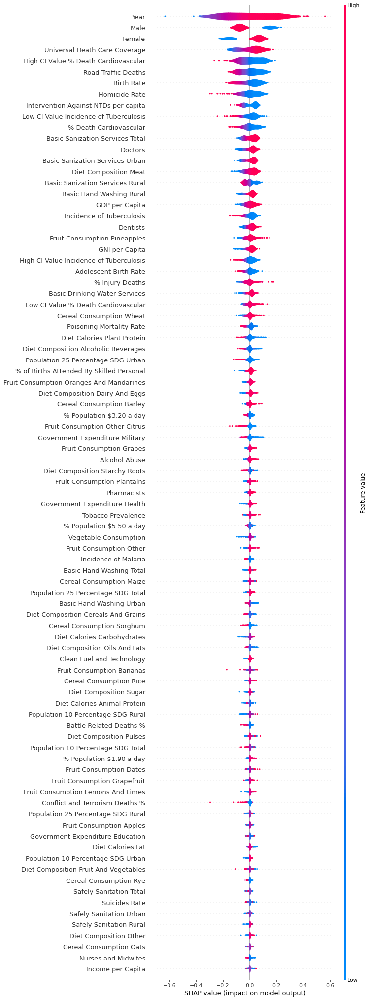

In [80]:
shap.summary_plot(shap_values[0], X_test_sample,max_display=X.shape[1], plot_type="violin")

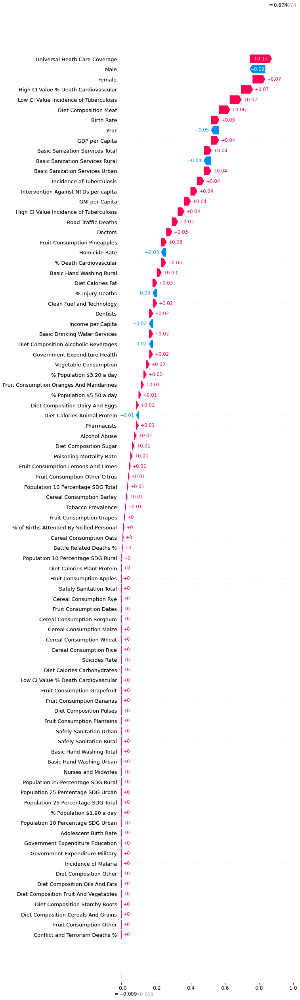

In [87]:
i=2
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[0], shap_values[0][i], feature_names=X.columns, max_display=X.shape[1])

In [88]:
shap.force_plot(explainer.expected_value[0], shap_values[0], X_test, link="logit")

___________________________________________________________________

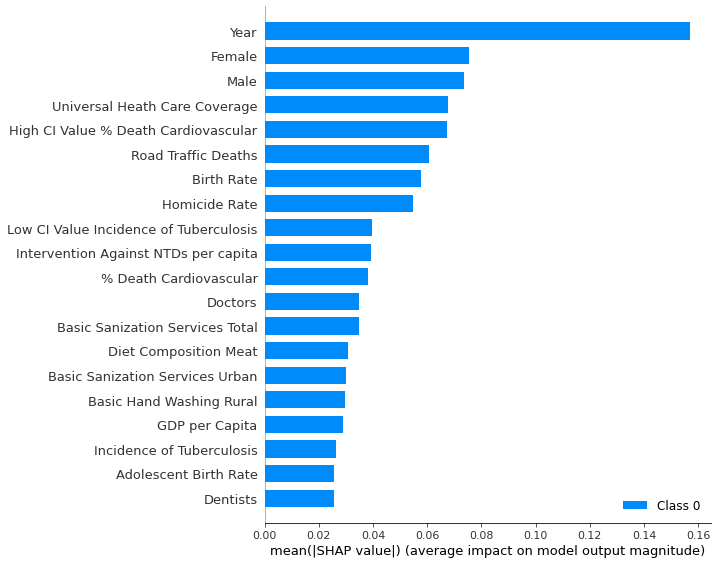

In [ ]:
shap.initjs()
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test)

Text(0.5, 1.0, 'Life Expectancy')

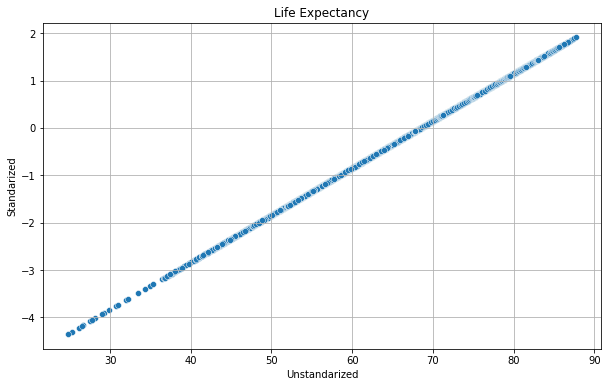

In [ ]:
plt.figure(figsize=(10,6))
sns.scatterplot(y=df['Life Expectancy'], x=df_filled['Life Expectancy'])
plt.grid()
plt.xlabel('Unstandarized')
plt.ylabel('Standarized')
plt.title('Life Expectancy')

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0][0], X_test.iloc[0,:])

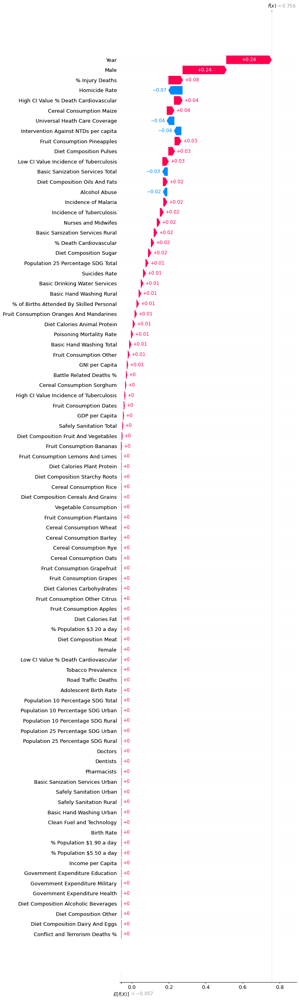

In [ ]:
i=0
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[0], shap_values[0][i], feature_names=X_train.columns, max_display=X_train.shape[1])

In [ ]:
# plot the SHAP values for the  output of all instances
shap.initjs()
shap.force_plot(explainer.expected_value[0], shap_values[0], X_test, link="logit")

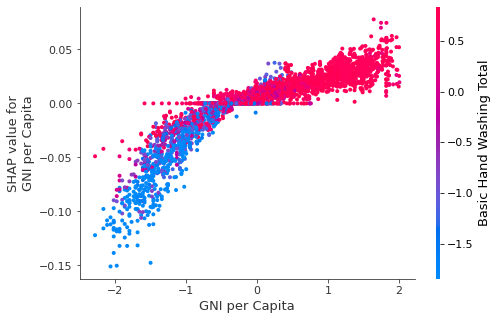

In [ ]:
shap.dependence_plot('GNI per Capita', shap_values[0], X_test)

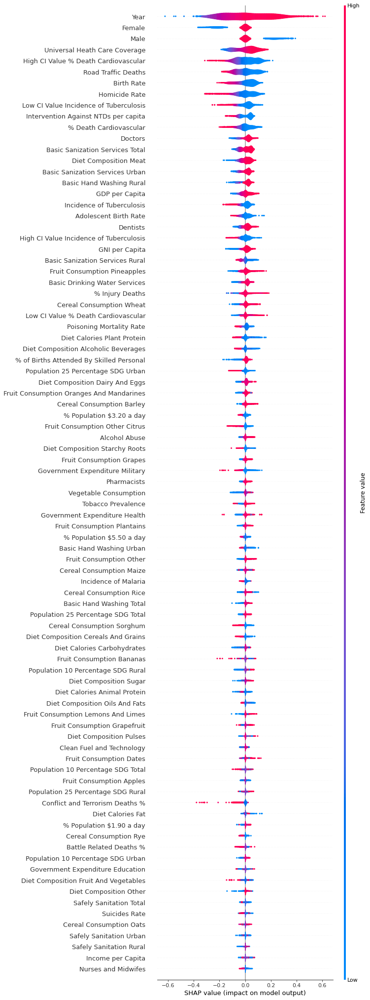

In [ ]:
shap.summary_plot(shap_values[0], X_test,max_display=X_test.shape[1], plot_type="violin")